<a href="https://colab.research.google.com/github/hariseldon99/msph402b/blob/main/Special_Topics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Special Topics

Solving Laplace Equation using the Jacobi Update
=================================================
Consider a wire of length $N$ kept at a constant voltage of $V=100$. Divide the two-dimensional space into a grid of size $N\times N$, with the wire running horizontally at the beginning of the grid. Then, solve Laplace's equation numerically using the Finite Difference Method with Jacobi updates, assuming that the potential is grounded at all the other edges. Laplace's equation is
\begin{equation*}
\frac{\partial^2u}{\partial x^2} + \frac{\partial^2u}{\partial y^2} = 0.
\end{equation*}

Running the Jacobi Update Solver ...


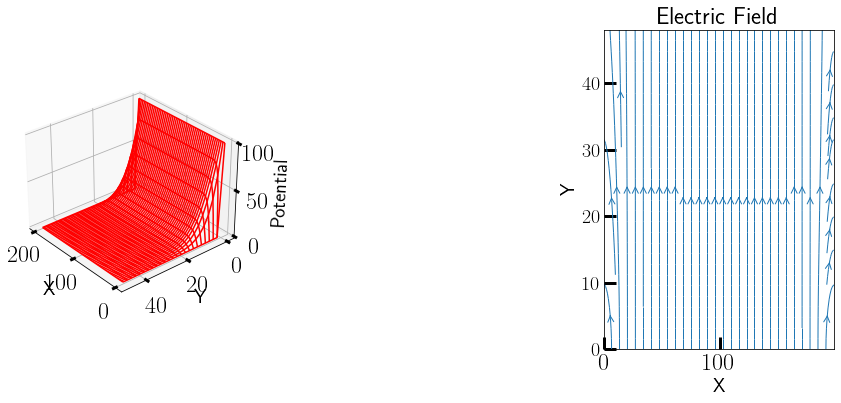

In [34]:
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,6)
plt.rcParams['font.size'] = 20


Nmax = 200
V_wire = 100

V = np.zeros((Nmax, Nmax))   
V[:,0] = V_wire                                     # Line at V_wire volts

print ("Running the Jacobi Update Solver ...")

def jacobi_update(V, Niter=70):
    Nmax = V.shape[0]
    for iter in range(Niter):
        for i in range(1, Nmax-2):                                                
            for j in range(1,Nmax-2): 
                V[i,j] = 0.25*(V[i+1,j]+V[i-1,j]+V[i,j+1]+V[i,j-1])  
    return V

V = jacobi_update(V)

x = np.arange(0, Nmax-1, 2);  y = np.arange(0, 50, 2)                              
X, Y = np.meshgrid(x,y)                 

def functz(V):                                         # V(x, y) 
    z = V[X,Y]                        
    return z

Z = functz(V)    

fig = plt.figure()

ax = fig.add_subplot(131,projection='3d')
ax.plot_wireframe(X, Y, Z, color = 'r')               # Red wireframe
ax.set_xlabel('X')                                     
ax.set_ylabel('Y')
ax.set_zlabel('Potential')
ax.view_init(30, 140) #Perspective

Eym, Exm = np.gradient(Z)

ax2 = fig.add_subplot(133)
ax2.set_title("Electric Field")
ax2.streamplot(X, Y, -Exm, -Eym, linewidth=1, density=1, arrowstyle='->', arrowsize=1.5)
ax2.set_xlabel('X')                                     
ax2.set_ylabel('Y')
plt.show()                                              # Show fig

Now, let us consider two plates inside a grounded box. The top plate is kept at $V=100\;V$ and the bottom at $V=-100\;V$. The two plates constitute a capacitor connected to a battery. Obtain the potential and electric field as a function of space and plot them. 

Running the Jacobi Update Solver ...


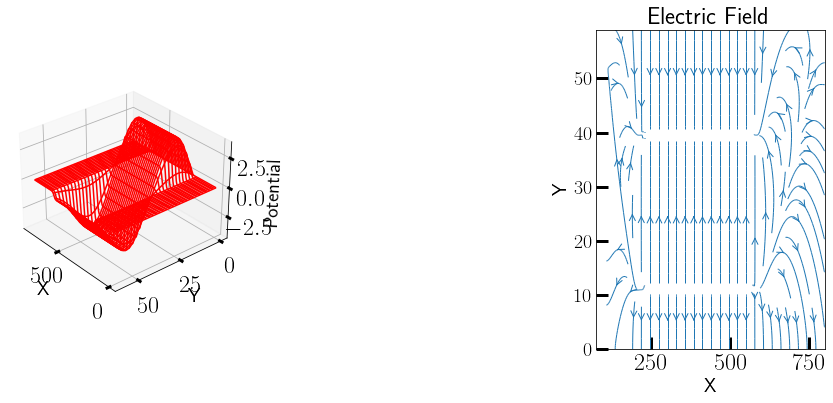

In [19]:
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,6)
plt.rcParams['font.size'] = 20


Nmax = 800
V_wire = 100
V = np.zeros((Nmax, Nmax))   

x_start = 200
y_start = 10
separation = 30

V[x_start:Nmax-x_start,y_start] = V_wire                                     # Line at V_wire volts
V[x_start:Nmax-x_start,y_start+separation] = -V_wire                                     # Line at V_wire volts

print ("Running the Jacobi Update Solver ...")

def jacobi_update(V, Niter=90):
    Nmax = V.shape[0]
    for iter in range(Niter):
        for i in range(1, Nmax-2):                                                
            for j in range(1,Nmax-2): 
                V[i,j] = 0.25*(V[i+1,j]+V[i-1,j]+V[i,j+1]+V[i,j-1])  
    return V

V = jacobi_update(V)

offset = 20
x = np.arange(0, Nmax-1, 1);  y = np.arange(0, y_start+separation+offset, 1)                              
X, Y = np.meshgrid(x,y)                 

def functz(V):                                         # V(x, y) 
    z = V[X,Y]                        
    return z

Z = functz(V)    

fig = plt.figure()

ax = fig.add_subplot(131,projection='3d')
ax.plot_wireframe(X, Y, Z, color = 'r')               # Red wireframe
ax.set_xlabel('X')                                     
ax.set_ylabel('Y')
ax.set_zlabel('Potential')
ax.view_init(30, 140) #Perspective

Eym, Exm = np.gradient(Z)

ax2 = fig.add_subplot(133)
ax2.set_title("Electric Field")
ax2.streamplot(X, Y, -Exm, -Eym, linewidth=1, density=1, arrowstyle='->', arrowsize=1.5)
ax2.set_xlabel('X')                                     
ax2.set_ylabel('Y')
plt.show()                                              # Show fig

Done! Now Building Amimation ...


Animation size has reached 31475718 bytes, exceeding the limit of 31457280.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


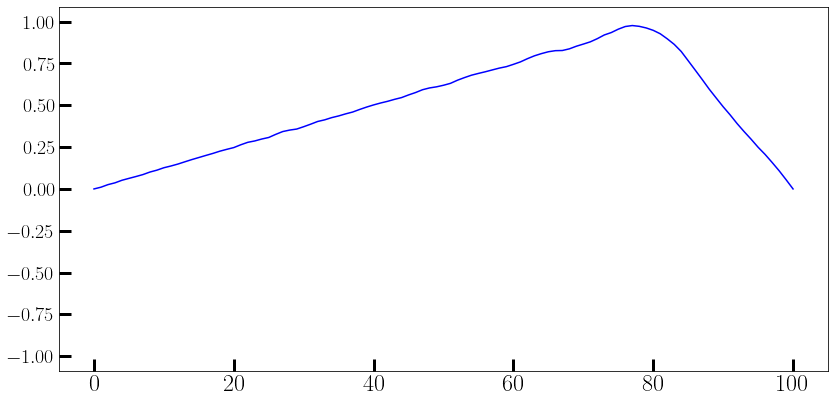

In [34]:
%matplotlib inline
from IPython.display import HTML
import numpy as np
import matplotlib.pyplot as plt
from celluloid import Camera

plt.rcParams['figure.figsize'] = (12,6)
plt.rcParams['font.size'] = 20
plt.rcParams['font.size'] = 20
plt.rcParams['animation.embed_limit'] = 30

# Parameters
cc1 = 0.9
ratio =  cc1**2
N = 100
tmax = 2000

# Initialization
xi = np.zeros((N+1,3))

risept = int(0.8 * N)

riseind = np.arange(risept+1)
xi[riseind, 0 ] =   1.25 * riseind/N

fallind = np.arange(risept+1,N+1)
xi[fallind, 0 ] =  5. * (1- (fallind/N))

fig = plt.figure()
camera = Camera(fig)

# Later time steps
for i in range(1, N): 
    xi[i,1] = xi[i,0] + 0.5*ratio*(xi[i+1,0]+xi[i-1,0]-2*xi[i,0])

for t in range(tmax):                               
    for i in range(1, N):              
        xi[i,2] = 2.*xi[i,1] - xi[i,0] + ratio * (xi[i+1,1]+xi[i-1,1]-2*xi[i, 1])

    xi[:,0] = xi[:, 1]
    xi[:,1] = xi[:, 2]
    f = plt.plot(np.arange(N+1),xi[:,1],'b')
    camera.snap()
    
print("Done! Now Building Amimation ...")
anim = camera.animate(blit=False, interval=30)
HTML(anim.to_jshtml(default_mode="once"))


The Numerov Algorithm in Python
=====================================

Use the Numerov Algorithm to obtain the eigenstates of the Harmonic Oscillator. The Hamiltonian is

\begin{equation*}
H = \frac{p^2}{2} + x^2
\end{equation*}

Analytically, the eigenvalues are given by $E_n = 2n+1$. What happens if you add a perturbation $H\rightarrow H + \alpha x^4$ to the Hamiltonian?

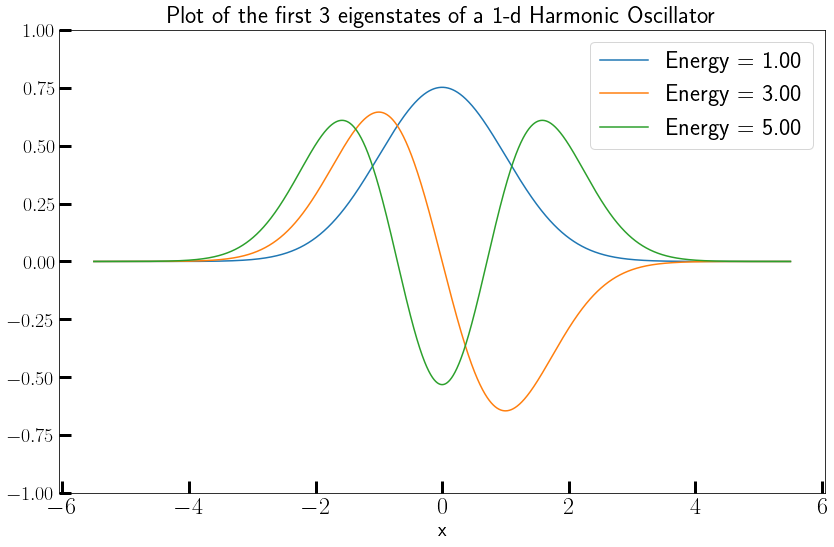

In [ ]:
import numpy as np
from scipy.integrate import simps
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20

def numerov_schrodinger_1d(x0, Vx0, E, dpsi=1e-5):
    '''
    Numerov algorithm

            2 * [1 - 5 * h1^2 * k^2(n)] * y(n) - [1 + h1^2 * k^2(n-1)] * y(n-1)
  y(n+1) = ------------------------------------------------------------------
                                    [1 + h1^2 * k^2(n+1)]

    where

        h1 = h^2_0/12

        k(n) = E - Vx0(x0(n))
    '''

    psi = np.zeros(x0.size)

    psi[0] = 0.0
    psi[1] = dpsi

    h0 = x0[1] - x0[0]

    ksq = E - Vx0

    h12 = h0**2 / 12.

    for ii in range(2, x0.size):
        psi[ii] = 2 * (1 - 5 * h12 * ksq[ii-1]) * psi[ii-1] - \
                    (1 + h12 * ksq[ii-2]) * psi[ii-2]
        psi[ii] /= 1 + h12 * ksq[ii]

    # Normalization by Simpson's Method
    psi /= np.sqrt(simps(psi**2, x=x0))
    return psi


# Harmonic Oscillator V(x) = x^2 with pert
a = 0.0
x = np.linspace(-5.5, 5.5, 3000)
Vx = x**2 + a * x**4
neigen = 3
energies = 2 * np.arange(neigen) +1

for e in energies:
    plt.plot(x, numerov_schrodinger_1d(x, Vx, e),
             label=f"Energy = {e:1.2f}")

plt.title(f"Plot of the first {len(energies)} eigenstates\
                        of a 1-d Harmonic Oscillator")
plt.legend()
plt.xlabel('x')

plt.ylim(-1.0, 1.0)
plt.show()

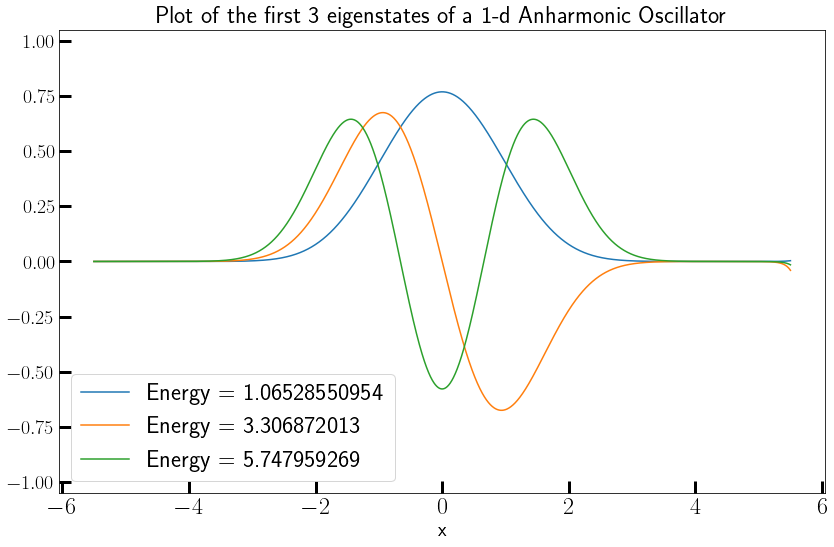

In [ ]:
import numpy as np
from scipy.integrate import simps
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20

# Harmonic Oscillator V(x) = x^2 with pert
a = 0.1
x = np.linspace(-5.5, 5.5, 3000)
Vx = x**2 + a * x**4

#energies = [1.06]
#energies = [1.07]
energies = [1.06528550954, 3.30687201300, 5.747959269]

for e in energies:
    plt.plot(x, numerov_schrodinger_1d(x, Vx, e),
             label=f"Energy = {e}")

plt.title(f"Plot of the first {len(energies)} eigenstates\
                        of a 1-d Anharmonic Oscillator")
plt.legend()
plt.xlabel('x')

plt.ylim(-1.05, 1.05)
plt.show()

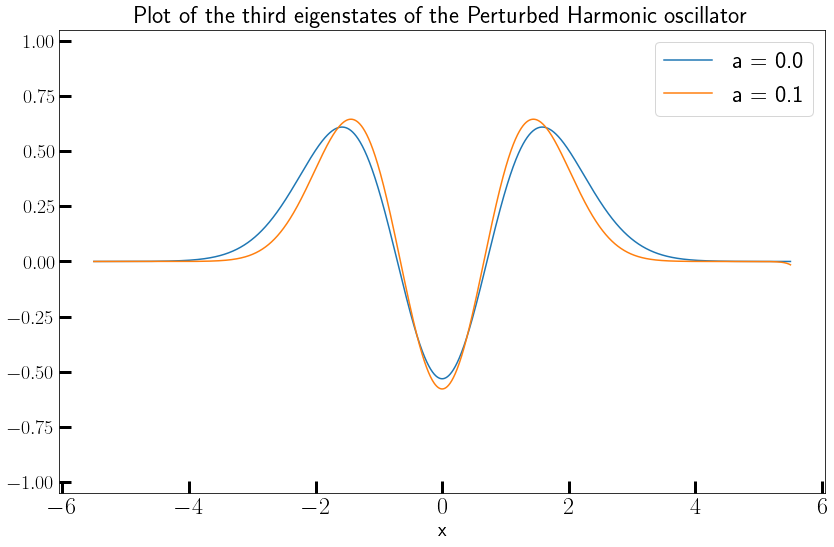

In [ ]:
import numpy as np
from scipy.integrate import simps
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20

# Harmonic Oscillator V(x) = x^2 with pert
avals = [0.0, 0.1]
evals = [5.0, 5.747959269]
x = np.linspace(-5.5, 5.5, 3000)

for i,a in enumerate(avals):
    plt.plot(x, numerov_schrodinger_1d(x, x**2 + a * x**4, evals[i]),
             label=f"a = {a}")

plt.title(f"Plot of the third eigenstates of the Perturbed Harmonic oscillator")
plt.legend()
plt.xlabel('x')

plt.ylim(-1.05, 1.05)
plt.show()

Introduction to QuTiP - The Quantum Toolbox in Python
=====================================

QuTiP is a python package for calculations and numerical simulations of quantum systems.

It includes facilities for representing and doing calculations with quantum objects such state vectors (wavefunctions), as bras/kets/density matrices, quantum operators of single and composite systems, and superoperators (useful for defining master equations).

It also includes solvers for a time-evolution of quantum systems, according to: Schrodinger equation, von Neuman equation, master equations, Floquet formalism, Monte-Carlo quantum trajectors, experimental implementations of the stochastic Schrodinger/master equations.

For more information see the project web site at https://qutip.org/, and the documentation at https://qutip.org/docs/latest/index.html. Follow the instructions there in order to download and install QuTiP.




To use QuTiP in a Python program, first inlude the `qutip` module:

In [ ]:
import numpy as np
from qutip import *

### Creating and inspecting quantum objects

We can create a new quantum object using the `Qobj` class constructor, like this:

In [ ]:
q = Qobj([[1], [0]])

q

Quantum object: dims = [[2], [1]], shape = (2, 1), type = ket
Qobj data =
[[1.]
 [0.]]

Here we passed python list as an argument to the class constructor. The data in this list is used to construct the matrix representation of the quantum objects, and the other properties of the quantum object is by default computed from the same data.

We can inspect the properties of a `Qobj` instance using the following class method:

In [ ]:
# the dimension, or composite Hilbert state space structure
q.dims

[[2], [1]]

In [ ]:
# get the dense matrix representation
q.full()

array([[1.+0.j],
       [0.+0.j]])

In [ ]:
# some additional properties
q.isherm, q.type

(False, 'ket')

### Using `Qobj` instances for calculations

With `Qobj` instances we can do arithmetic and apply a number of different operations using class methods:

In [ ]:
sy = Qobj([[0,-1j], [1j,0]])  # the sigma-y Pauli operator

sy

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[0.+0.j 0.-1.j]
 [0.+1.j 0.+0.j]]

In [ ]:
sz = Qobj([[1,0], [0,-1]]) # the sigma-z Pauli operator

sz

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[ 1.  0.]
 [ 0. -1.]]

In [ ]:
# some arithmetic with quantum objects

H = 1.0 * sz + 0.1 * sy

print("Two-Level Hamiltonian (qubit) = \n")
H

Two-Level Hamiltonian (qubit) = 



Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[ 1.+0.j   0.-0.1j]
 [ 0.+0.1j -1.+0.j ]]

In [ ]:
# The raw data of H can be extracted and put into a numpy array as follows
H.full()

array([[0.+0.j, 1.+0.j],
       [1.+0.j, 0.+0.j]])

In [ ]:
# The hermitian conjugate
sy.dag()

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[0.+0.j 0.-1.j]
 [0.+1.j 0.+0.j]]

In [ ]:
# The trace
H.tr()

0.0

In [ ]:
# Eigen energies
H.eigenenergies()

array([-1.,  1.])

## States and operators

Normally we do not need to create `Qobj` instances from stratch, using its constructor and passing its matrix representation as argument. Instead we can use functions in QuTiP that generates common states and operators for us. Here are some examples of built-in state functions. These obtain matrix representations of states and observables in the so-called "*Bosonic Occupation Number Representation*", which is basically the basis given by

\begin{equation*}
|n_1, n_2, n_3, \dots n_N\rangle.
\end{equation*}

In this state, $n_i$ identical bosons populate state $i$, and there are $N$ single particle states in total.
### State vectors

In [ ]:
# Fundamental basis states (Fock states of oscillator modes)

N = 2 # number of single particle states
n = 1 # the state that will be occupied

basis(N, n)    # equivalent to fock(N, n)

Quantum object: dims = [[2], [1]], shape = (2, 1), type = ket
Qobj data =
[[0.]
 [1.]]

In [ ]:
# Fundamental basis states (Fock states of oscillator modes)

N = 4 # number of states in the Hilbert space
n = 2 # the state that will be occupied

basis(N, n)    # equivalent to fock(N, n)

Quantum object: dims = [[4], [1]], shape = (4, 1), type = ket
Qobj data =
[[0.]
 [0.]
 [1.]
 [0.]]

### Operators

#### Qubit (two-level system) operators

In [ ]:
# Pauli sigma x
sigmax()

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[0. 1.]
 [1. 0.]]

In [ ]:
# Pauli sigma y
sigmay()

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[0.+0.j 0.-1.j]
 [0.+1.j 0.+0.j]]

In [ ]:
# Pauli sigma z
sigmaz()

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[ 1.  0.]
 [ 0. -1.]]

#### Creation and Annihilation operators

In [ ]:
# creation operator for N=8 particles
N=8
create(N) # equivalent to destroy(5).dag()

Quantum object: dims = [[8], [8]], shape = (8, 8), type = oper, isherm = False
Qobj data =
[[0.         0.         0.         0.         0.         0.
  0.         0.        ]
 [1.         0.         0.         0.         0.         0.
  0.         0.        ]
 [0.         1.41421356 0.         0.         0.         0.
  0.         0.        ]
 [0.         0.         1.73205081 0.         0.         0.
  0.         0.        ]
 [0.         0.         0.         2.         0.         0.
  0.         0.        ]
 [0.         0.         0.         0.         2.23606798 0.
  0.         0.        ]
 [0.         0.         0.         0.         0.         2.44948974
  0.         0.        ]
 [0.         0.         0.         0.         0.         0.
  2.64575131 0.        ]]

#### Using `Qobj` instances we can check some well known commutation relations:

In [ ]:
def commutator(op1, op2):
    return op1 * op2 - op2 * op1

Now, let us create a creation operator and an annihilation operator and prove that they commute, *i.e*

\begin{equation*}
\left[a, a^\dagger\right] = a\;a^\dagger - a^\dagger a = 1
\end{equation*}

In [ ]:
N = 10

#Annihilation operator
a = destroy(N)

print(commutator(a, a.dag()))

Quantum object: dims = [[10], [10]], shape = (10, 10), type = oper, isherm = True
Qobj data =
[[ 1.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  1.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  1.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  1.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  1.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  1.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  1.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  1.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  1.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0. -9.]]


**Oops...** The result is not exactly identity (look at the last element)! Why? Because we have truncated the Hilbert space at $10$ particles, but the exact Hilbert space has infinite particles. The last $-9$ is a **truncation error**. As long as our truncation is reasonably large, this should not pose a serious problem.

What about the algebra of spin operators? Let us prove that

\begin{align*}
\left[\sigma_x, \sigma_y\right] &= 2i\sigma_z,\\
-i \sigma_x \sigma_y \sigma_z &= \mathbf{1}
\end{align*}


In [ ]:
print(commutator(sigmax(), sigmay()) - 2j * sigmaz())
print("\n\n")
print(-1j * sigmax() * sigmay() * sigmaz())

Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[0. 0.]
 [0. 0.]]



Quantum object: dims = [[2], [2]], shape = (2, 2), type = oper, isherm = True
Qobj data =
[[1. 0.]
 [0. 1.]]


## Systems of Bosons in QuTiP

Let us consider a test Hamiltonian, the tight-binding model. Here, there are $N$ lattice-sites, labelled by the number $i$, in one-dimension . Each lattice site can either be empty in a vacuum state $|0\rangle$, or 'create' a particle in a Wannier state $|i\rangle$ localized at that site. Thus, we can define creation and annihilation operators $c_i, c^\dagger_i$ such that

\begin{align*}
c^\dagger_i|0\rangle &= |i\rangle \\
c |i\rangle &= |0\rangle \\
c^\dagger_i|i\rangle &= c|0\rangle = 0.
\end{align*}

Now, the 'tightly-bound' Hamiltonian simply involves nearest-neighbour tunneling and nothing else. Thus

\begin{equation*}
H = \frac{1}{2}\sum^{N-1}_{i=0} \left(c^\dagger_i c_{i+1} + c^\dagger_{i+1}c_i\right)
\end{equation*}


In this hamiltonian, each site can now be thought of as a 'state' (the Wannier state $|i\rangle$). Now, we have already seen how `QuTip` has a routine called `basis(N,k)` that can create a population at state $k$ for $N$ particles. If we pretend that the $k-$s are actually Wannier states at lattice sites $k$, then the Hamiltonian can be built trivially in `QuTip` as shown in the example below.

In [ ]:
#N = 100
N = 30

H = sum([basis(N,i) * basis(N, i + 1).dag() for i in range(N - 1)]) +\
    sum([basis(N,i) * basis(N, i - 1).dag() for i in range(1, N)])


Here, the `sum()` routine is also from `QuTip`. Now, let us diagonalize this Hamiltonian and plot the eigenvalues

In [ ]:
evals = H.eigenenergies()
# satisfy periodic boundary conditions we need E(-k) = E(k)
numerical = np.concatenate((np.flip(evals, 0), evals), axis=0)

Now, consider the analytical solution of the eigenvalue problem $H|\psi_k\rangle = \epsilon_k |\psi_k\rangle$, which are the Bloch states given by $|\psi_k\rangle = \sum_n e^{-ink}|k\rangle$ with eigenvalues $\epsilon_k = -2\cos{k}$, where $k$ is a lattice momentum lying in the First Brillouin Zone, *i.e* $k_n = 2\pi/n\in [-\pi,\pi]$. Let us compare the analytical and numerical solutions.



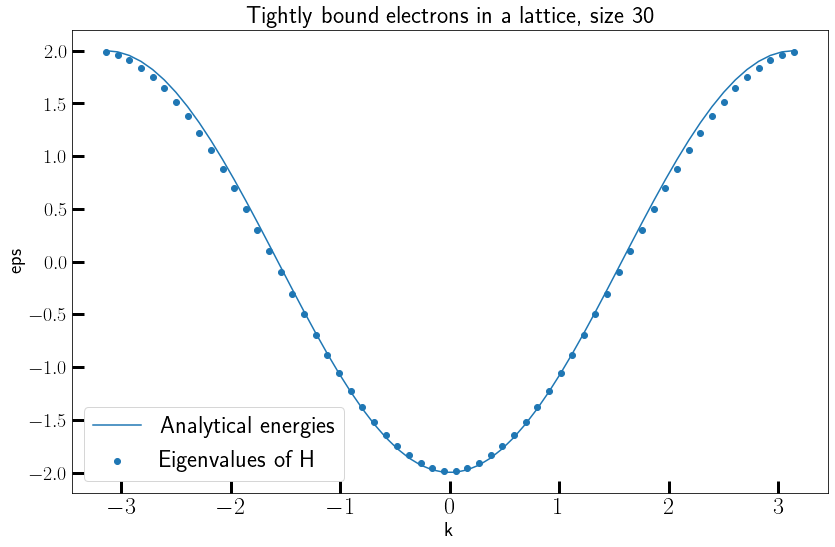

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20
k = np.linspace(-np.pi, np.pi, 2*N)

#plt.scatter(k[::3],numerical[::3].real, label='Eigenvalues of H')
plt.scatter(k,numerical.real, label='Eigenvalues of H')

analytical = -2 * np.cos(k)
plt.title(f"Tightly bound electrons in a lattice, size {N}")
plt.plot(k,analytical, label='Analytical energies')
plt.xlabel("k")
plt.ylabel("eps")
plt.legend()
plt.show()

## Systems of Fermions in QuTiP

Fermions are a little harder to simulate in `QutiP`, but they can be done. Consider a system of $N$ coupled spin-$1/2$ particles. The Hamiltonian is given by

\begin{equation*}
H = \sum^{N-1}_{i=0}\omega_i \sigma^z_i +  g\sum^{N-1}_{i=0}\sigma^x_i\sigma^x_{i+1}
\end{equation*}

We have to be a little careful with our choice of $N$, since the dimensions of the Hamiltonian scale as $2^N\times 2^N$, so if our $N$ is too large, we'll swiftly run out of computer memory *and* disk space. This happens because each spin-$1/2$ has a Hilbert space dimension of $2$, and the terms in the sum above are actually shorthand for the full exact operators, which involve tensor products with unity at the empty sites, thus, a term like $\sigma^x_i\sigma^x_{i+1}$ will actually become a full tensor product of $N-2$ unit matrices and two $\sigma_x$s. For example, in a system 
of $5$ such fermions

\begin{align*}
\sigma^x_0\sigma^x_1 & \rightarrow \sigma^x \otimes\sigma^x \otimes \mathbf{1}\otimes \mathbf{1}\otimes \mathbf{1}\\
\sigma^x_1\sigma^x_2 & \rightarrow \mathbf{1}\otimes \sigma^x \otimes\sigma^x \otimes \mathbf{1}\otimes \mathbf{1}\\
\dots & \dots \\
\sigma^x_3\sigma^x_4 &\rightarrow \mathbf{1}\otimes \mathbf{1}\otimes \mathbf{1}\otimes \sigma^x \otimes\sigma^x \\
\dots & \dots \\
\sigma^z_0&\rightarrow \sigma^z \otimes \mathbf{1}\otimes \mathbf{1}\otimes \mathbf{1} \otimes\mathbf{1}\\
\sigma^z_1&\rightarrow \mathbf{1}\otimes\sigma^z \otimes \mathbf{1}\otimes \mathbf{1}\otimes \mathbf{1} \\
\sigma^z_2&\rightarrow \mathbf{1}\otimes \mathbf{1}\otimes \sigma^z\otimes \mathbf{1} \otimes\mathbf{1}\\
\dots & \dots
\end{align*}

Let us keep $N<11$. Suppose $N=3$. Let us vary $\omega_1$ and keep everything else fixed, and plot the energy eigenvalues as functions of $\omega_1$ using `QuTiP`. The $\otimes$ operation can be done using the `tensor()` function, and the identity $\mathbf{1}$ can be obtained from the `qeye()` function.

In [ ]:
def evals_multw(w1list, w2, w3, g12, g13):

    # Pre-compute operators for the hamiltonian
    sz1 = tensor(sigmaz(), qeye(2), qeye(2))
    sx1 = tensor(sigmax(), qeye(2), qeye(2))

    sz2 = tensor(qeye(2), sigmaz(), qeye(2))
    sx2 = tensor(qeye(2), sigmax(), qeye(2))

    sz3 = tensor(qeye(2), qeye(2), sigmaz())
    sx3 = tensor(qeye(2), qeye(2), sigmax())
  
    evals_mat = np.zeros((len(w1list),2**3))
    for idx, w1 in enumerate(w1list):
        # evaluate the Hamiltonian
        H = w1 * sz1 + w2 * sz2 + w3 * sz3 +\
            g12 * sx1 * sx2 + g13 * sx1 * sx3
        # find the energy eigenvalues of the composite system
        evals = H.eigenenergies()
        evals_mat[idx,:] = np.real(evals)

    return evals_mat

In [ ]:
w1  = 1.0 * 2 * np.pi   # atom 1 frequency: sweep this one
w2  = 0.9 * 2 * np.pi   # atom 2 frequency
w3  = 1.1 * 2 * np.pi   # atom 3 frequency
g12 = 0.05 * 2 * np.pi   # atom1-atom2 coupling strength
g13 = 0.05 * 2 * np.pi   # atom1-atom3 coupling strength

w1list = np.linspace(0.75, 1.25, 50) * 2 * np.pi # atom 1 frequency range
evals_mat = evals_multw(w1list, w2, w3, g12, g13)

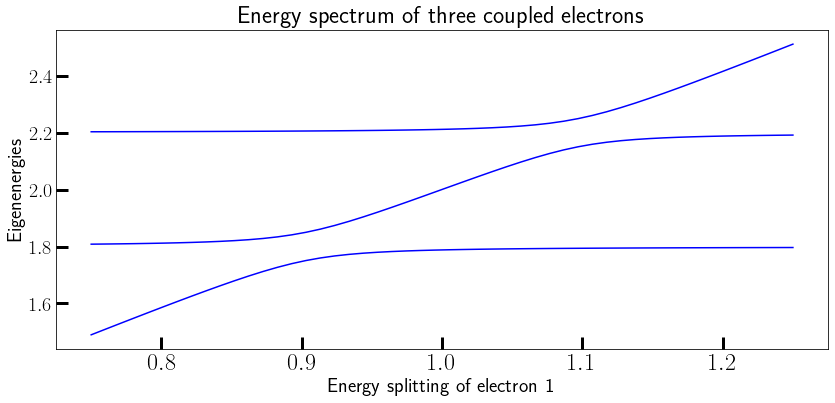

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['font.size'] = 20
fig, ax = plt.subplots(figsize=(12,6))

for n in [1,2,3]:
    ax.plot(w1list / (2*np.pi), (evals_mat[:,n]-evals_mat[:,0]) / (2*np.pi), 'b')

ax.set_xlabel('Energy splitting of electron 1')
ax.set_ylabel('Eigenenergies')
ax.set_title('Energy spectrum of three coupled electrons')
plt.show()

## Unitary dynamics

Unitary evolution of a quantum system in `QuTiP` can be calculated with the `mesolve` function. This solves the Schrodinger equation

\begin{equation*}
H|\psi\rangle = i \frac{d}{dt}|\psi\rangle,
\end{equation*}

using prebuilt numerical methods. The name `mesolve` is short for Master-eqaution solve (for dissipative dynamics), but if no collapse operators (which describe the dissipation) are given to the solve it falls back on the unitary evolution of the Schr\"odinger equation.

The evolution solvers in QuTiP returns a class of type `Odedata`, which contains the solution to the problem posed to the evolution solver. 

For example, considor a single spin-$1/2$ particle with Hamiltonian $H = \sigma_x$ and initial state $\left|1\right>$ (in the $\sigma_z-$basis): Its evolution can be calculated as follows:

In [ ]:
# Hamiltonian
H = sigmax()

# initial state
psi0 = basis(2, 0)

# list of times for which the solver should store the state vector
tlist = np.linspace(0, 10, 100)

result = mesolve(H, psi0, tlist, [], [])
print(result)

Result object with sesolve data.
--------------------------------
states = True
num_collapse = 0


In [ ]:
result.states[-1] # the finial state

Quantum object: dims = [[2], [1]], shape = (2, 1), type = ket
Qobj data =
[[-0.8390774+0.j        ]
 [ 0.       +0.54401206j]]

### Expectation values

The expectation values of an operator given a state vector or density matrix (or list thereof) can be calculated using the `expect` function. 

In [ ]:
expect(sigmaz(), result.states)

array([ 1.        ,  0.97966324,  0.91948013,  0.82189857,  0.69088756,
        0.53177579,  0.3510349 ,  0.15601625, -0.04534808, -0.24486795,
       -0.43442821, -0.60631884, -0.75354841, -0.87012859, -0.95131766,
       -0.99381332, -0.99588712, -0.95745468, -0.88007921, -0.76690787,
       -0.62254375, -0.45285867, -0.26475429, -0.06588149,  0.13567091,
        0.33170513,  0.51424779,  0.67587427,  0.81001063,  0.91120109,
        0.97532984,  0.99978853,  0.9835823 ,  0.92737033,  0.83343897,
        0.70560878,  0.54907906,  0.37021643,  0.17629587, -0.02479521,
       -0.22487778, -0.41581382, -0.58983733, -0.73987014, -0.85980992,
       -0.94477826, -0.9913192 , -0.99753971, -0.96318677, -0.88965766,
       -0.77994308, -0.63850553, -0.4710978 , -0.28452892, -0.08638732,
        0.11526793,  0.31223484,  0.49650212,  0.660575  ,  0.79778003,
        0.90253662,  0.97058393,  0.99915421,  0.98708537,  0.9348683 ,
        0.84462688,  0.72003156,  0.56615011,  0.38924141,  0.19

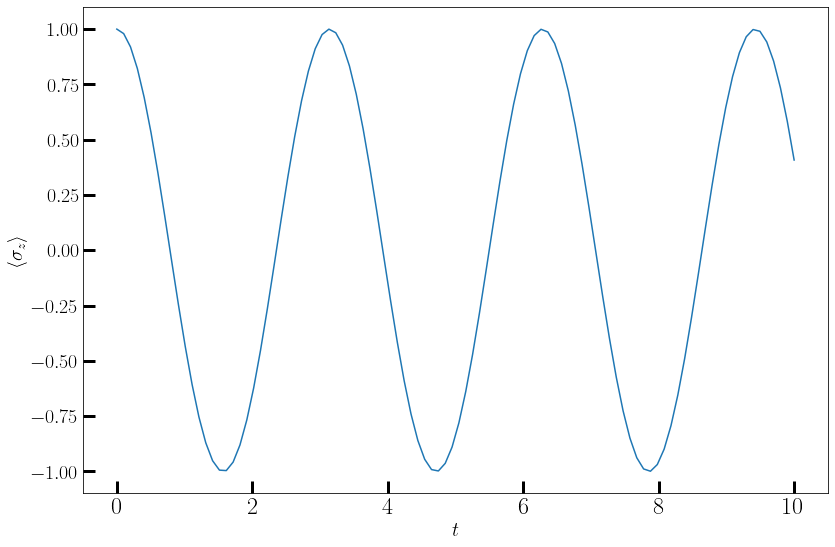

In [ ]:
fig, axes = plt.subplots(1,1)

axes.plot(tlist, expect(sigmaz(), result.states))

axes.set_xlabel(r'$t$', fontsize=20)
axes.set_ylabel(r'$\left<\sigma_z\right>$', fontsize=20);

Introduction to Monte Carlo Methods in Python
=====================================

### Spontaneous Decay Simulation:

A sample of $N$ radioactive atoms undergo spontanneous decay in time. The probability of an atom to decay within a given time interval $\Delta t$ is proportional to the length of time. Thus, if $N$ atoms reduce to $N-\Delta N$ in time $\Delta t$,
\begin{equation*}
P = -\lambda \Delta t  = \frac{\Delta N}{N},
\end{equation*}
where $\lambda$ is the decay rate. In the continuum limit, where $\Delta N \ll N$, we can approximate the result above by the differential equation $\displaystyle\frac{dN}{dt} = -\lambda N$, yielding an exponential decay $N(t) = N_0e^{-\lambda t}$. However, we shall use Monte Carlo methods to simulate the exact process, and compare this to the continuum solution. The algorithm is simple. At each time, for each undecayed atom, choose a uniform random number $r$ and decrement the number of atoms only if $r < \lambda$. This yields the number of atoms at every time step.

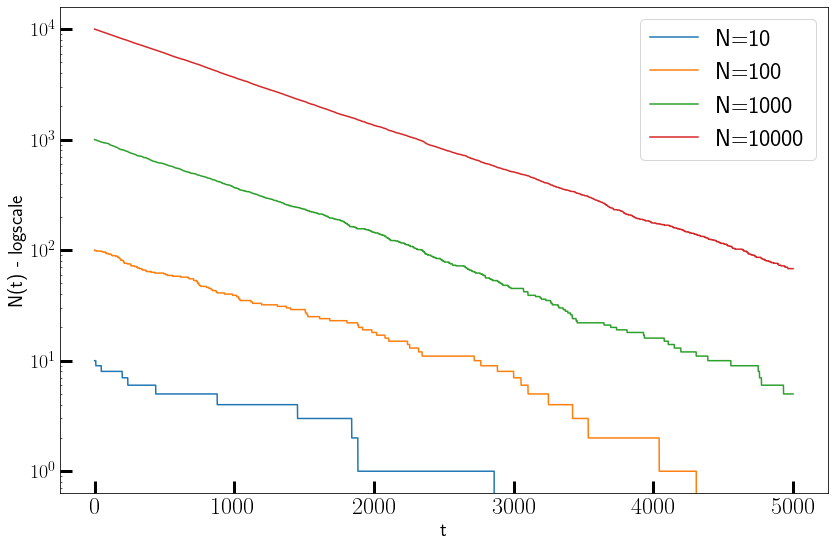

In [13]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20

# Decay constant
lambda1 = 1e-3

natoms_arr = [10, 100, 1000, 10000]
maxtime = 5000

timeline = np.arange(0, maxtime  + 1)
for natoms in natoms_arr:
    natoms_begin = natoms
    natoms_time = []
    for time in timeline:
        decays = np.random.random(natoms)
        natoms -= np.count_nonzero(decays < lambda1)
        natoms_time.append(natoms)
    
    plt.plot(timeline, natoms_time,label=f'N={natoms_begin}')

plt.ylabel("N(t) - logscale")
plt.xlabel("t")
plt.yscale("log")
plt.legend()
plt.show()

### Stimulated Emission
Devise and test a model for spontaneous decay including the effect of *stimulated emission*. This might describe decaying particles trapped within a cavity. One approach is to modify the spontaneous decay simulation above by having the decay rate $\lambda$ increase as the number of atoms increases. Suppose that
\begin{equation*}
P = -\lambda\left(1 + \alpha\frac{ N(t)}{ N (0)}\right) \Delta t  = \frac{\Delta N(t)}{N},
\end{equation*}

We can simply modify the code above by updating the value of $\lambda$ at each time step as follows

\begin{equation*}
\lambda \rightarrow \lambda\left(1 + \alpha\frac{ N(t)}{ N (0)}\right)
\end{equation*}

First, let us define $r = \alpha/\lambda$.

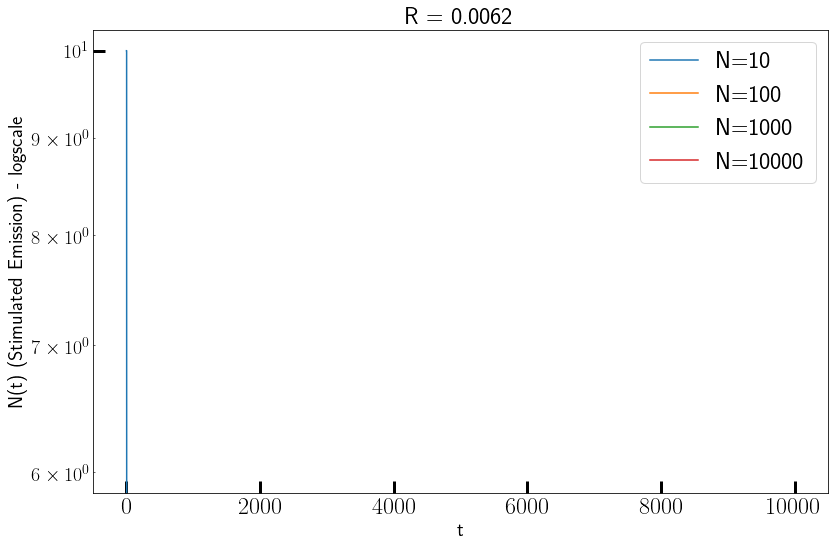

In [171]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20

# r = 1e-7
# r = 4e-7
# r = 1e-3
r = 6.2e-3
# r = 1e-2

# Decay constant
lambda1 = 1e-3
alpha = r/lambda1

natoms_arr = [10, 100, 1000, 10000]
maxtime = 10000

timeline = np.arange(0, maxtime  + 1)
for natoms in natoms_arr:
    natoms_begin = natoms
    natoms_time = []
    for time in timeline:
        decays = np.random.random(natoms)
        natoms -= np.count_nonzero(decays < lambda1)
        # Update the value of lambda1
        lambda1 *= 1 + alpha * natoms/natoms_begin
        natoms_time.append(natoms)
    
    plt.plot(timeline, natoms_time,label=f'N={natoms_begin}')

plt.title(f"R = {r}")
plt.ylabel("N(t) (Stimulated Emission) - logscale")
plt.xlabel("t")
plt.yscale("log")
plt.legend()
plt.show()

### 2D Random Walk (Landau 7.3.1 Ex1)

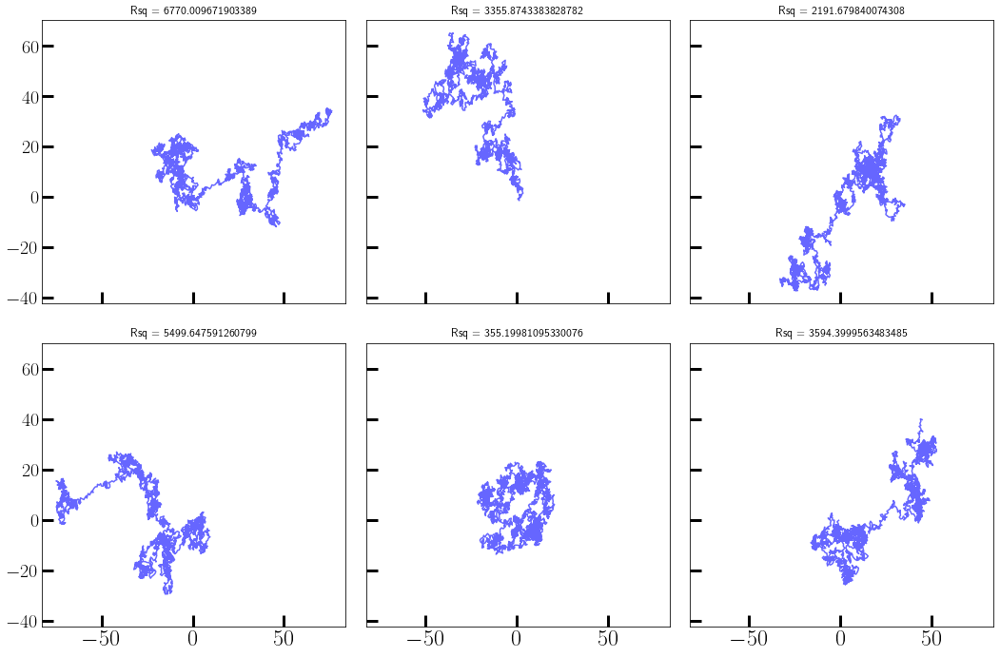

In [69]:
import numpy as np
plt.rcParams['figure.figsize'] = (15,10)
plt.rcParams['font.size'] = 20

fig, axs = plt.subplots(2,3, sharex=True, sharey=True)
axs = axs.flatten()

jmax = 2500

for ax in axs:
    dr_vals = 2.0 * np.random.random((jmax,2)) -1 # dx, dy points between -1 and 1
    Lvals = np.sum(dr_vals**2, axis=1) # Vector lengths of those points
    dr_vals /= np.sqrt(Lvals[:, None]) # Normalize the points

    points = np.cumsum(dr_vals, axis=0) #Perform the random walk
    Rsq = np.linalg.norm(points[-1])**2
    ax.set_title(f"Rsq = {Rsq}", fontsize=12)
    ax.plot(points[:,0], points[:,1], color='blue', alpha=0.6)

plt.show()

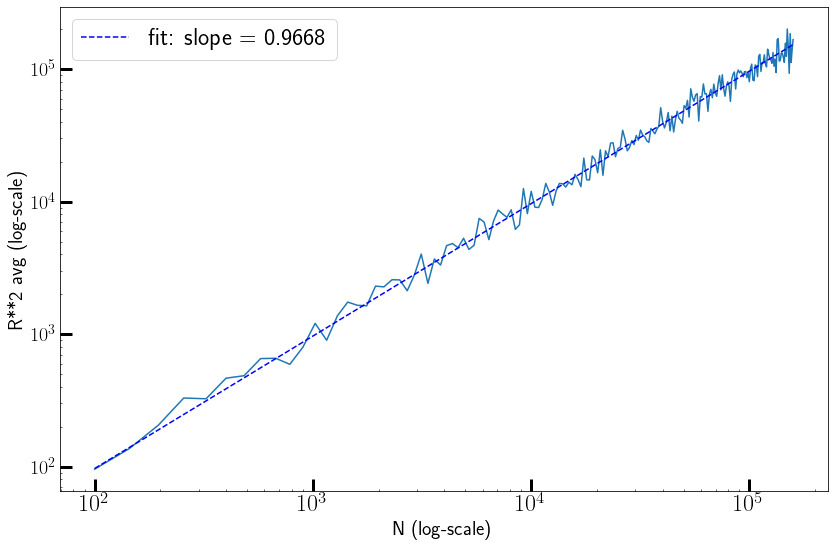

CPU times: user 20.5 s, sys: 55.9 ms, total: 20.6 s
Wall time: 20.8 s


In [70]:
%%time
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import numpy as np
plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20

def randwalk2d(nsteps, repeat=6):
    '''
    Returns numpy arrays of coordinates constituting a 2D random walk, 
    Starting from the origin (0,0)

            Parameters:
                    nsteps (int): Number of steps in a random walk
                    repeat (int): Number of independent random walks. 
                                Default is 6.

            Returns:
                    A list of numpy arrays, each constituting an ordered 
                    sequence of random walks
    '''
    points = []
    for i in range(repeat):
        dr_vals = 2.0 * np.random.random((nsteps,2)) -1 # dx, dy points between -1 and 1
        Lvals = np.sum(dr_vals**2, axis=1) # Vector lengths of those points
        dr_vals /= np.sqrt(Lvals[:, None]) # Normalize the points
        points.append(np.cumsum(dr_vals, axis=0)) #Perform the random walk
    return points

nsteps = np.arange(10,400,2)**2

Rsq_avs = []
for nstp in nsteps:
    walks = randwalk2d(nstp, repeat=50)
    Rsq_avs.append(np.average([np.linalg.norm(w[-1])**2 for w in walks]))
plt.loglog(nsteps, Rsq_avs)

popt, pcov = curve_fit(lambda x,a: a * x, nsteps, Rsq_avs)
plt.loglog(nsteps, popt[0] * nsteps, 'b--', label=f'fit: slope = {popt[0]:2.4f}')
plt.xlabel("N (log-scale)")
plt.ylabel("R**2 avg (log-scale)")

plt.legend()
plt.show()